<a href="https://colab.research.google.com/github/abhi57075/GANs/blob/main/DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DCGAN - Deep Convolutional GANs

DCGAN does not see real images, its generator uses feedback from the discriminator to create realistic images

# Importing the libraries

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
tf.__version__

'2.15.0'

# Loading and preprocessing the dataset

In [ ]:
(X_train, y_train), (_, _) = tf.keras.datasets.mnist.load_data()

11490434/11490434 [==============================] - 0s 0us/step


In [ ]:
X_train.shape # This means there are 60K images in the mnist dataset each of which has the shape of 28x28

(60000, 28, 28)

In [ ]:
28 * 28

784

In [ ]:
y_train.shape

(60000,)

6


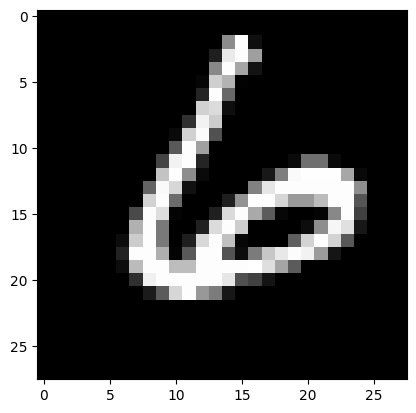

In [ ]:
i = np.random.randint(0, 60000)
#print(i)
print(y_train[i])
plt.imshow(X_train[i], cmap='gray');

In [ ]:
X_train = X_train.reshape(X_train.shape[0], 28, 28, 1).astype('float32') # Reshaping X_train

In [ ]:
X_train.shape

(60000, 28, 28, 1)

In [ ]:
X_train[0].min(), X_train[0].max()

(0.0, 255.0)

In [ ]:
X_train = (X_train - 127.5) / 127.5 # normalizing the range of X_train, For DCGAN it is prefered to keep the range from(-1.0,1.0)

In [ ]:
X_train[0].min(), X_train[0].max()

(-1.0, 1.0)

In [ ]:
buffer_size = 60000
batch_size = 256

In [ ]:
buffer_size / batch_size # mini-batch gradient descent algorithm - > We are going to create 234 batches and inside each batch we are going to store 256 images
# It means that we will send one batch of 256 images and the weights will be adjusted, after that we send one more batch of 256 images, then the weights will be updated
# We are going to send the images batch by batch

234.375

In [ ]:
type(X_train)

numpy.ndarray

In [ ]:
# We need to convert X_train to tensorflow format in order to send it to the neural network
# Shuffle -> to avoid so that the neural network will learn the order of the images
X_train = tf.data.Dataset.from_tensor_slices(X_train).shuffle(buffer_size).batch(batch_size)
# We are going to train the neural network sending batches of 234 images

In [ ]:
type(X_train)

tensorflow.python.data.ops.batch_op._BatchDataset

In [ ]:
X_train

<_BatchDataset element_spec=TensorSpec(shape=(None, 28, 28, 1), dtype=tf.float32, name=None)>

# Building the generator

- Batch normalization: https://keras.io/api/layers/normalization_layers/batch_normalization/
- Leaky Relu: https://keras.io/api/layers/activation_layers/leaky_relu/
- Funções de ativação: https://medium.com/@himanshuxd/activation-functions-sigmoid-relu-leaky-relu-and-softmax-basics-for-neural-networks-and-deep-8d9c70eed91e
- Padding: https://www.pico.net/kb/what-is-the-difference-between-same-and-valid-padding-in-tf-nn-max-pool-of-tensorflow

In [ ]:
7 * 7 * 256

12544

In [ ]:
# A dense layer is when the neuron of one layer is connected to all other neurons of the next layer
# Units is the number of neurons
# use_bias = False -> in most neural networks the bias unit is used. However we dont need to use it in the generator, since we are actually not training a neural
#                     network to classify images. The goal is to receive random noise and generate new images
# Batch Normalization -> Similar to normalizing the pixels range, but it will apply the normalization calculation in the layers of the neural network
# When padding = same, all pixels of the image are being used
# When padding = valid, all pixels of the image are not being used


# Conv2D used for downsampling
# Conv2DTranspose used for upsampling

# # Padding==Same:
# H = H1 * stride

# Padding==Valid
# H = (H1-1) * stride + HF

# where, H = output size, H1 = input size, HF = height of filter

In [ ]:
# 100 -> 12544
def build_generator():
  network = tf.keras.Sequential()

  network.add(layers.Dense(units = 7*7*256, use_bias = False, input_shape=(100,)))
  network.add(layers.BatchNormalization())
  network.add(layers.LeakyReLU())

  network.add(layers.Reshape((7,7,256))) # To convert the vector of pixels to matrix of pixels

  # 7x7x128
  network.add(layers.Conv2DTranspose(filters = 128, kernel_size = (5,5), padding = 'same', use_bias = False))
  network.add(layers.BatchNormalization())
  network.add(layers.LeakyReLU())

  # 14x14x64
  network.add(layers.Conv2DTranspose(filters = 64, kernel_size = (5,5), padding = 'same', strides = (2,2), use_bias = False))
  network.add(layers.BatchNormalization())
  network.add(layers.LeakyReLU())

  # 28x28x1
  network.add(layers.Conv2DTranspose(filters = 1, kernel_size = (5,5), padding = 'same', strides = (2,2), use_bias=True, activation='tanh'))
  # Filters = 1 since there is only one color channel (grayscale) if we want color images, then filters = 3
  # We used activation = tanh because tanh ranges from -1 to 1, we used this because we had normalized pixels in this range
  # If normalization was in the range of (0 to 1) we would have used sigmoid activation function

  network.summary()

  return network

In [ ]:
generator = build_generator()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 12544)             1254400   
                                                                 
 batch_normalization (Batch  (None, 12544)             50176     
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 12544)             0         
                                                                 
 reshape (Reshape)           (None, 7, 7, 256)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 7, 7, 128)         819200    
 anspose)                                                        
                                                                 
 batch_normalization_1 (Bat  (None, 7, 7, 128)         5

In [ ]:
generator.input

<KerasTensor: shape=(None, 100) dtype=float32 (created by layer 'dense_input')>

In [ ]:
noise = tf.random.normal([1, 100])
noise

<tf.Tensor: shape=(1, 100), dtype=float32, numpy=
array([[-0.02384391,  0.8061869 , -1.7127006 ,  1.1094912 , -0.715323  ,
         0.98963034, -0.01332037, -3.018271  ,  0.5708377 ,  0.40125003,
        -0.9431628 ,  0.7076197 ,  0.77117765,  0.8991738 , -0.25515944,
         1.4708546 , -1.0171741 ,  1.2533065 ,  0.19513501, -0.518834  ,
        -1.0562645 , -0.45117685,  0.10446338, -0.9828625 ,  0.14542751,
        -0.07418592,  0.93980503, -0.01071147, -1.5300187 ,  1.1606989 ,
        -0.20119715,  0.13086653,  1.268779  ,  0.9599246 , -1.5975199 ,
        -0.48404986, -0.20590046, -0.60443354,  0.5687986 , -0.05235551,
         1.5787992 , -0.57898843,  0.4956957 , -0.03267853, -0.42654455,
        -0.10837042, -0.12037693, -0.74555206,  1.5452149 ,  0.07512382,
        -2.03023   , -1.1991405 ,  0.44956285,  0.5022607 ,  0.5319147 ,
        -0.5264536 ,  0.09259601,  0.06415176,  0.5873557 , -1.1125946 ,
        -2.0987668 ,  0.54125786,  0.2134455 ,  0.09400717, -0.15633573,
 

In [ ]:
generated_image = generator(noise, training = False)

In [ ]:
generated_image.shape

TensorShape([1, 28, 28, 1])

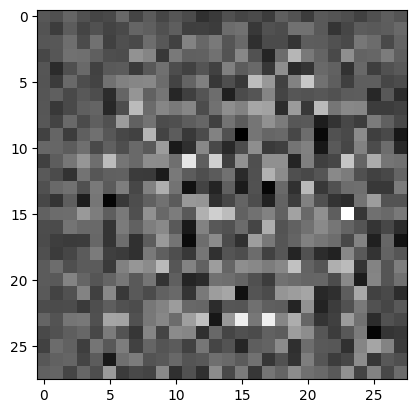

In [ ]:
plt.imshow(generated_image[0, :,:,0], cmap='gray');

# Building the discriminator

- Dropout: https://jmlr.org/papers/volume15/srivastava14a/srivastava14a.pdf
- Conv2d x Conv2dTranspose: https://stackoverflow.com/questions/68976745/in-keras-what-is-the-difference-between-conv2dtranspose-and-conv2d

In [ ]:
def build_discriminator():
  network = tf.keras.Sequential()

  # 14x14x64
  network.add(layers.Conv2D(filters = 64, strides = (2,2), kernel_size = (5,5), padding = 'same', input_shape = [28,28,1]))
  network.add(layers.LeakyReLU())
  network.add(layers.Dropout(0.3))

  # 7x7x128
  network.add(layers.Conv2D(filters = 128, strides = (2,2), kernel_size = (5,5), padding = 'same'))
  network.add(layers.LeakyReLU())
  network.add(layers.Dropout(0.3))

  network.add(layers.Flatten()) # will convert matrix to vector
  network.add(layers.Dense(1)) # only 1 neuron at the output layer since it will return a probability or a number between 0 and 1.
  # Here we havent specified any activation function so the output wont indicate a probability.
  # If we dont specify any activation function the result is in logit format

  network.summary()

  return network

In [ ]:
7 * 7 * 128

6272

In [ ]:
discriminator = build_discriminator()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 14, 14, 64)        1664      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 14, 14, 64)        0         
                                                                 
 dropout (Dropout)           (None, 14, 14, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 7, 7, 128)         204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 7, 7, 128)         0         
                                                                 
 dropout_1 (Dropout)         (None, 7, 7, 128)         0         
                                                                 
 flatten (Flatten)           (None, 6272)             

In [ ]:
discriminator.input

<KerasTensor: shape=(None, 28, 28, 1) dtype=float32 (created by layer 'conv2d_input')>

In [ ]:
discriminator(generated_image, training = False) # logits

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[0.00079688]], dtype=float32)>

In [ ]:
tf.sigmoid(-0.00081761)
# The answer is 50% because the discriminator hasnt been trained yet
# The closer to one the real the image, close to 0 faker the image

<tf.Tensor: shape=(), dtype=float32, numpy=0.49979565>

# Error calculation

- Logits: https://deepai.org/machine-learning-glossary-and-terms/logit

This method quantifies how well the discriminator is able to distinguish real images from fakes images. It compares the discriminator predictions on real images with an array of 1s and the discriminator predictions on fake (generated) images with an array of 0s.

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits = True) # from_logits = True because the output of the discriminator is logits

In [ ]:
tf.ones_like(1)

<tf.Tensor: shape=(), dtype=int32, numpy=1>

In [ ]:
def discriminator_loss(expected_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(expected_output), expected_output) # Real Images are equivalent to 1
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

In [ ]:
def generator_loss(fake_output):
  return cross_entropy(tf.ones_like(fake_output), fake_output)

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(learning_rate = 0.00001)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate = 0.00001)

# Training the GAN and visualizing the results

- Based on: https://www.tensorflow.org/beta/tutorials/generative/dcgan
- @tf.function: https://www.tensorflow.org/guide/function#:~:text=You%20can%20use%20tf.,is%20required%20to%20use%20SavedModel%20.


In [ ]:
X_train

<_BatchDataset element_spec=TensorSpec(shape=(None, 28, 28, 1), dtype=tf.float32, name=None)>

In [ ]:
epochs = 100 # The GAN will trained only for 100 epochs
noise_dimension = 100
number_of_images = 16 # Number of images that we are going to generate to test the GAN -> 16 images

In [ ]:
batch_size, noise_dimension

(256, 100)

In [ ]:
@tf.function
def train(images):
  noise = tf.random.normal([batch_size, noise_dimension])
  #print(noise.shape)
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape: # We are going to calculate the gradient or the direction to update the weights of the generator and the dicriminator
    generated_images = generator(noise, training = True)

    expected_output = discriminator(images, training = True)
    fake_output = discriminator(generated_images, training = True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(expected_output, fake_output)

  generator_gradients = gen_tape.gradient(gen_loss, generator.trainable_variables) # updating weights by giving them direction like if the weights are 0.2 whether to go to 0.1 or 0.3
  discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables)) # update the weights
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

In [ ]:
tf.config.run_functions_eagerly(True)
X_train_batch = X_train.as_numpy_iterator().next()
train(X_train_batch)

In [ ]:
test_images = tf.random.normal([number_of_images, noise_dimension])
test_images.shape

TensorShape([16, 100])

In [ ]:
60000 / 256

234.375

In [ ]:
def train_gan(dataset, epochs, test_images):
  for epoch in range(epochs):
    print(epoch)
    for image_batch in dataset:
      #print(image_batch.shape, end = " ")
      print([i for i in range(10000)], end = " ")
      train(image_batch)
    print()

    # print('Epoch: ', epoch + 1)
    # generated_images = generator(test_images, training = False)
    # fig = plt.figure(figsize = (10,10))
    # for i in range(generated_images.shape[0]):
    #   plt.subplot(4,4,i + 1)
    #   plt.imshow(generated_images[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    #   plt.axis('off')
    # plt.show()

In [ ]:
train_gan(X_train, epochs, test_images)

0
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 22

KeyboardInterrupt: ignored